<a href="https://colab.research.google.com/github/Angelgupta13/Deep-learning-/blob/main/linear_autoencoder_vs_PCA_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import os
import random
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
from torchvision import transforms
from torchvision.datasets import MNIST
from tqdm.auto import tqdm
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE


### Seed Everything ###
torch.manual_seed(0)
torch.cuda.manual_seed(0)
np.random.seed(0)
random.seed(0)

# I am resizing the 28x28 image to 32x32 just so its a power of 2! just for conviennce
transform = transforms.Compose(
    [
        transforms.Resize((32,32)),
        transforms.ToTensor()
    ]
)

train_set = MNIST("../../../data/mnist/", train=True, transform=transform, download=True)
test_set = MNIST("../../../data/mnist/", train=False, transform=transform, download=True)

### SET DEVICE ###
device = "cuda" if torch.cuda.is_available() else "cpu"

100%|██████████| 9.91M/9.91M [00:00<00:00, 18.4MB/s]
100%|██████████| 28.9k/28.9k [00:00<00:00, 487kB/s]
100%|██████████| 1.65M/1.65M [00:00<00:00, 4.60MB/s]
100%|██████████| 4.54k/4.54k [00:00<00:00, 7.04MB/s]


In [2]:
class LinearAutoEncoder(nn.Module):
    def __init__(self, bottleneck_size=2):
        super().__init__()

        self.encoder = nn.Sequential(
            nn.Linear(32*32, bottleneck_size),
        )

        self.decoder = nn.Sequential(
            nn.Linear(bottleneck_size, 32*32),
        )

    def forward(self, x):

        batch, channels, height, width = x.shape

        ### Flatten Image to Vector ###
        x = x.flatten(1)

        ### Pass Through Encoder ###
        enc = self.encoder(x)

        ### Pass Through Decoder ###
        dec = self.decoder(enc)

        ### Put Decoded Image Back to Original Shape ###
        dec = dec.reshape(-1,1,32,32) # batch size of -1. Instead, it tells the library (like NumPy or PyTorch) to automatically calculate that dimension based on the size of the original array and the other dimensions provided.

        return enc, dec

In [3]:
def train(model,
          train_set,
          test_set,
          batch_size,
          training_iterations,
          evaluation_iterations,
          verbose=False):

    print("Training Model!")
    print(model)

    ### Set the Device ###
    device = "cuda" if torch.cuda.is_available() else "cpu"

    ### Define the Model and Place on Device ###
    model = model.to(device)

    ### Set the Dataloaders ###
    trainloader = DataLoader(train_set, batch_size=batch_size, shuffle=True, num_workers=8)
    testloader = DataLoader(test_set, batch_size=batch_size, shuffle=False, num_workers=8)

    ### Set the Optimizer ###
    optimizer = optim.Adam(model.parameters(), lr=0.0005)

    ### Some List for logging ###
    train_loss = []
    evaluation_loss = []
    train_losses = []
    evaluation_losses = []

    ### List to store Encoded Data when Evaluating ###
    encoded_data_per_eval = []

    ### Create a Progress Bar ###
    pbar = tqdm(range(training_iterations))

    train = True
    step_counter = 0
    while train:

        for images, labels in trainloader:

            images = images.to(device)
            encoded, reconstruction = model(images)

            ### Simple MSE Loss ###
            loss = torch.mean((images - reconstruction)**2)
            train_loss.append(loss.item())

            loss.backward()
            optimizer.step()
            optimizer.zero_grad()

            if step_counter % evaluation_iterations == 0:

                model.eval()
                encoded_evaluations = []

                for images, labels in testloader:

                    images = images.to(device)
                    encoded, reconstruction = model(images)
                    loss = torch.mean((images - reconstruction)**2)
                    evaluation_loss.append(loss.item())

                    ### Store the Encoded Image with their Labels ###
                    encoded, labels = encoded.cpu().flatten(1), labels.reshape(-1,1)
                    encoded_evaluations.append(torch.cat((encoded, labels), axis=-1))

                ### Store All Testing Encoded Images ###
                encoded_data_per_eval.append(torch.concatenate(encoded_evaluations).detach())

                train_loss = np.mean(train_loss)
                evaluation_loss = np.mean(evaluation_loss)

                train_losses.append(train_loss)
                evaluation_losses.append(evaluation_loss)

                if verbose:
                    print("Training Loss", train_loss)
                    print("Evaluation Loss", evaluation_loss)

                ### Reset For Next Evaluation ###
                train_loss = []
                evaluation_loss = []

                model.train()

            step_counter += 1
            pbar.update(1)

            if step_counter >= training_iterations:
                print("Completed Training!")
                train = False
                break

    ### Store All Encoded Data as Numpy Arrays for each Eval Iteration ###
    encoded_data_per_eval = [np.array(i) for i in encoded_data_per_eval]

    print("Final Training Loss", train_losses[-1])
    print("Final Evaluation Loss", evaluation_losses[-1])

    return model, train_losses, evaluation_losses, encoded_data_per_eval

In [4]:
linear_model = LinearAutoEncoder(bottleneck_size=2)
model, train_losses, evaluation_losses, linear_encoded_data =train(linear_model,
                                                                    train_set,
                                                                    test_set,
                                                                    batch_size=64,
                                                                    training_iterations=25000,
                                                                    evaluation_iterations=250)#linear_encoded_data =encoded data per eval

Training Model!
LinearAutoEncoder(
  (encoder): Sequential(
    (0): Linear(in_features=1024, out_features=2, bias=True)
  )
  (decoder): Sequential(
    (0): Linear(in_features=2, out_features=1024, bias=True)
  )
)


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


  0%|          | 0/25000 [00:00<?, ?it/s]

Completed Training!
Final Training Loss 0.046090745240449905
Final Evaluation Loss 0.04589769925186588


| Use Case                       | Linear Autoencoder | Vanilla Autoencoder (`nn.Module`) |
| ------------------------------ | ------------------ | --------------------------------- |
| Dimensionality Reduction (PCA) | ✅                  | ✅ (non-linear)                    |
| Image Compression              | ❌ (too simple)     | ✅                                 |
| Generative Modeling            | ❌                  | ✅                                 |
| Data Denoising                 | Limited            | Good                              |
| Learning Complex Latent Spaces | ❌                  | ✅                                 |


In [5]:
def build_embedding_plot(encoding, title):
    encoding = pd.DataFrame(encoding, columns=["x", "y", "class"])
    encoding = encoding.sort_values(by="class")
    encoding["class"] = encoding["class"].astype(int).astype(str)

    for grouper, group in encoding.groupby("class"):
        plt.scatter(x=group["x"], y=group["y"], label=grouper, alpha=0.8, s=5)

    plt.title(title)
    plt.xlabel("x")
    plt.ylabel("y")
    plt.show()


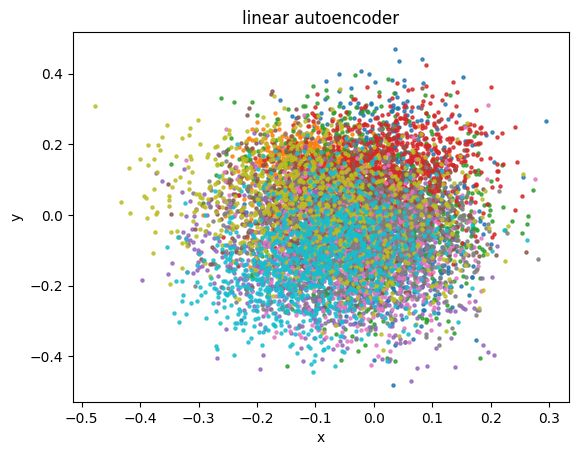

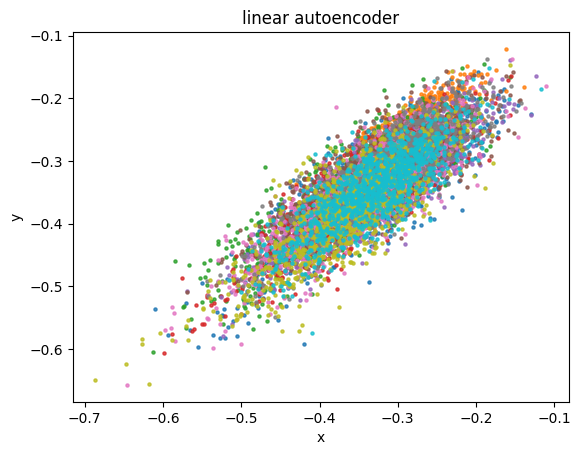

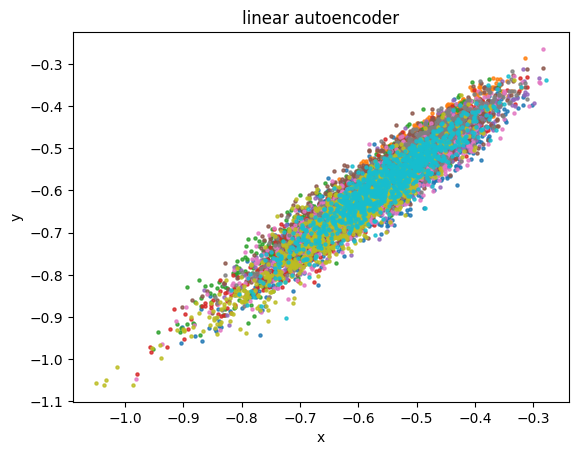

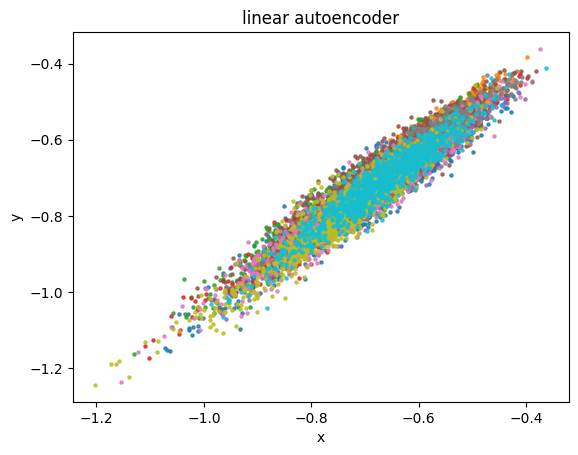

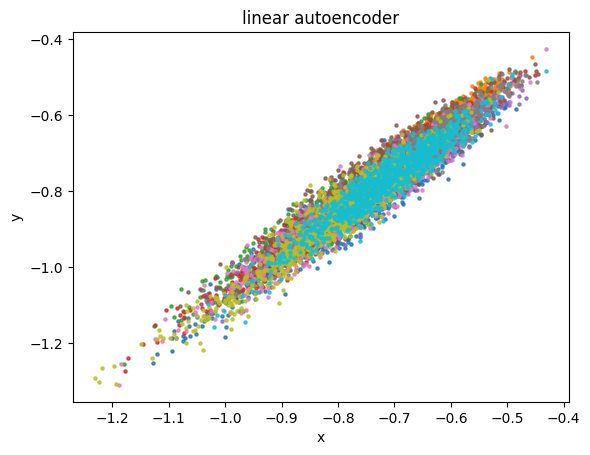

...

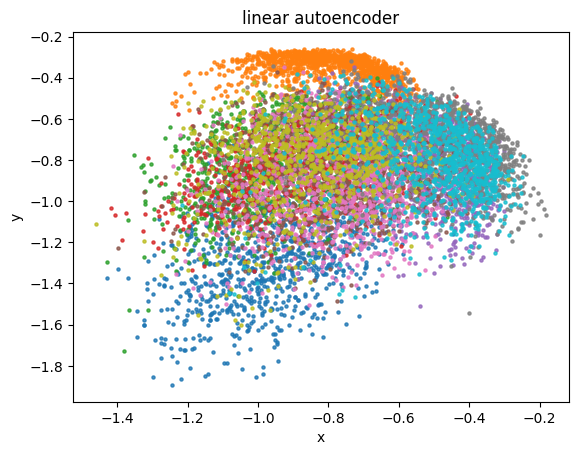

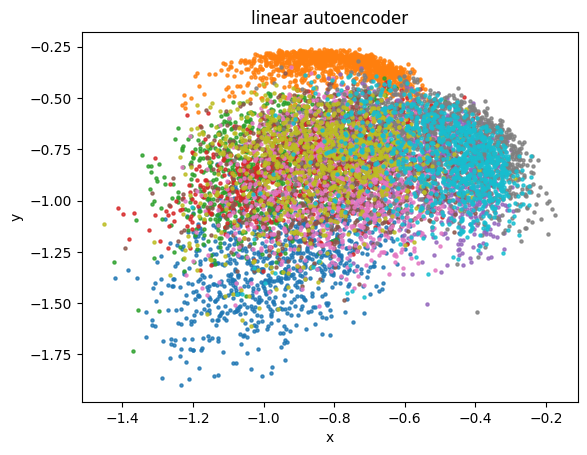

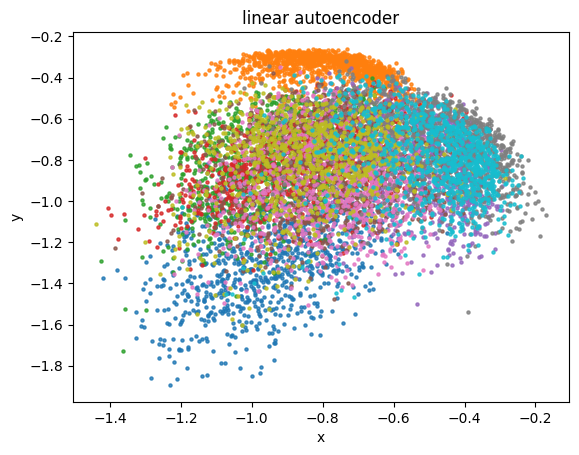

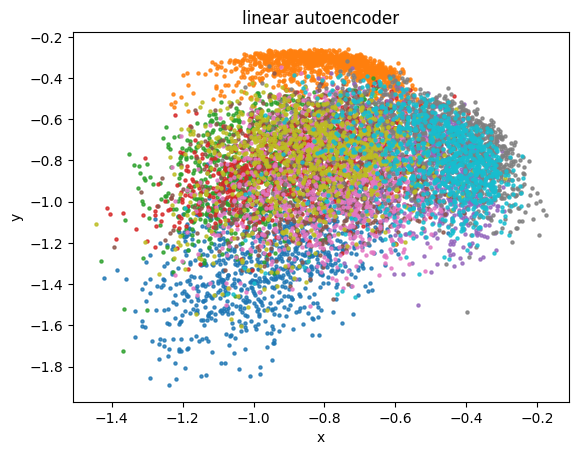

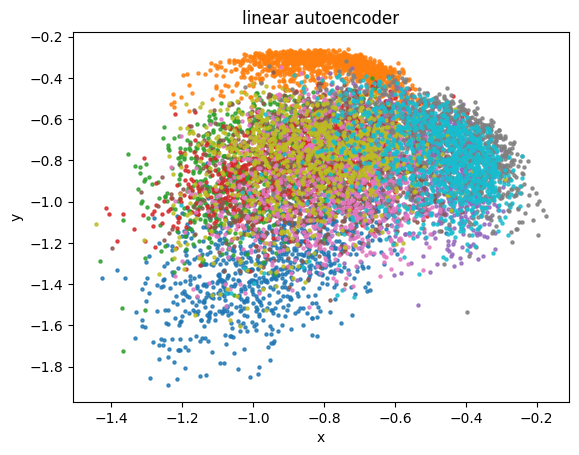

In [6]:
for i in range(len(linear_encoded_data)):
  build_embedding_plot(linear_encoded_data[i],"linear autoencoder")

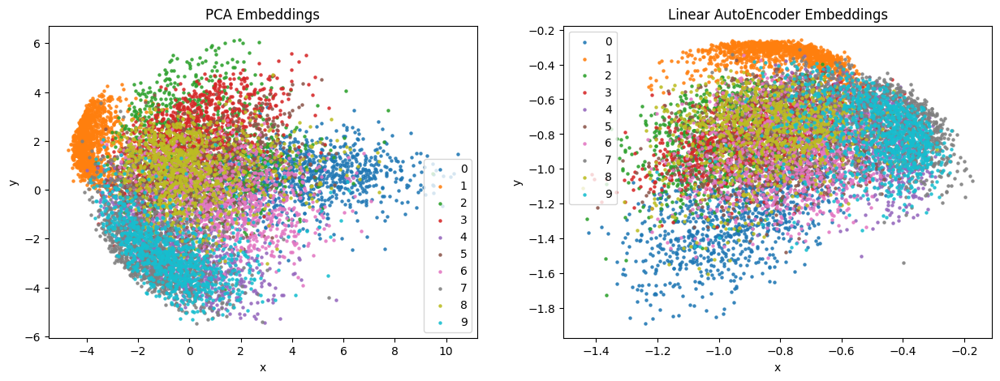

In [7]:
data = np.array(torch.cat([d[0].flatten(1) for d in test_set], dim=0))# Reducingdata: Flattens each image in the test set to a vector.

#labels: Collects corresponding class labels for each image.


labels = np.array([d[1] for d in test_set]).reshape(-1,1)

### PCA Encodings ###
pca = PCA(n_components=2)#This tells Principal Component Analysis (PCA) to reduce the data to 2 dimensions
pca_encoding = pca.fit_transform(data)
pca_encoding = np.concatenate((pca_encoding, labels), axis=-1)# make an array of imp flattened details
pca_encoding = pd.DataFrame(pca_encoding, columns=["x", "y", "class"])
pca_encoding = pca_encoding.sort_values(by="class")
pca_encoding["class"] = pca_encoding["class"].astype(int).astype(str)


### Grab Last Linear Encodings ###
linauto_encoding = linear_encoded_data[-1]
linauto_encoding = pd.DataFrame(linauto_encoding, columns=["x", "y", "class"])
linauto_encoding = linauto_encoding.sort_values(by="class")
linauto_encoding["class"] = linauto_encoding["class"].astype(int).astype(str)#prepare for ploting


### Lets Plot it All Now! ###
f, (ax1,ax2) = plt.subplots(1,2, figsize=(15,5))# it splits the plot in 2 parts

### Plot PCA Plot ###
for grouper, group in pca_encoding.groupby("class"):
    ax1.scatter(x=group["x"], y=group["y"], label=grouper, alpha=0.8, s=5)
ax1.legend()
ax1.set_xlabel("x")
ax1.set_ylabel("y")
ax1.set_title("PCA Embeddings")

for grouper, group in linauto_encoding.groupby("class"):
    ax2.scatter(x=group["x"], y=group["y"], label=grouper, alpha=0.8, s=5)
ax2.legend()
ax2.set_xlabel("x")
ax2.set_ylabel("y")
ax2.set_title("Linear AutoEncoder Embeddings")

plt.show()

pca brings down 1024*1024 dim to 2
these 2 components are
pc1,pc2
and are 90 to each other
a.b=abcostheta


In [8]:
### Principal Component Vectors ###
pc_1, pc_2 = torch.tensor(pca.components_[0]), torch.tensor(pca.components_[1])
print("Angle Between PCA Principal Components", torch.rad2deg(torch.acos(torch.dot(pc_1, pc_2))).item())

### Linear AutoEncoder Projection Vectors ###
model_weights = model.encoder[0].weight

weight_vector_1, weight_vector_2 = model_weights[0].cpu(), model_weights[1].cpu()
weight_vector_1 = weight_vector_1 / torch.norm(weight_vector_1)
weight_vector_2 = weight_vector_2 / torch.norm(weight_vector_2)

print("Angle Between AutoEncoder Vectors", torch.rad2deg(torch.acos(torch.dot(weight_vector_1, weight_vector_2))).item())

Angle Between PCA Principal Components 90.0
Angle Between AutoEncoder Vectors 91.23526763916016


2. torch.acos(...)
Computes the arc cosine (inverse cosine) of the dot product.

Returns the angle in radians.

3. torch.rad2deg(...)
Converts the angle from radians to degrees.

4. .item()
Converts the final PyTorch scalar tensor into a native Python float.



So model.encoder[0] gives the first linear layer.

.weight returns a tensor of shape [latent_dim, input_dim].

weight is [number of output neurons, number of input features]
These lines normalize the vectors.

This means their length becomes 1.

This is important because we want to measure only the angle, not affected by length.




important

🔄 Input → Encoder → Latent
Let’s say:

Input = image (784 features)

Encoder layer = nn.Linear(784, 2)

It compresses the 784 features into 2 values: z₁ and z₂

Then:

weight[0] = the vector used to compute z₁

weight[1] = the vector used to compute z₂

You're computing the angle between those two compression directions.

✅ Final Summary:
You are measuring the angle between two projection vectors (not between input and output), which tells how different or similar the two learned directions are in the encoder layer of your autoencoder.


